In [1]:
import torch
from torchvision import models, transforms
from PIL import Image
import matplotlib.pyplot as plt
import os
from PIL import Image
from sklearn.cluster import KMeans
import numpy as np
import random
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from matplotlib.offsetbox import OffsetImage, AnnotationBbox

In [2]:
# Define the image transformations
preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

def preprocess_image(image):
    # If the image is grayscale, convert it to RGB by duplicating the single channel
    if image.mode != 'RGB':
        image = image.convert('RGB')
    return preprocess(image).unsqueeze(0)  # Add batch dimension


# Visualize the image using matplotlib
def imshow(img_tensor):
    
    img_tensor = img_tensor.squeeze(0)  # remove the batch dimension
    img_tensor = img_tensor.permute(1, 2, 0)  # change dimensions to (H, W, C)
    img_tensor = img_tensor * torch.tensor([0.229, 0.224, 0.225]) + torch.tensor([0.485, 0.456, 0.406])  # un-normalize
    img_tensor = torch.clamp(img_tensor, 0, 1)  # clamp to [0,1]
    
    plt.imshow(img_tensor)
    plt.axis('off')
    plt.show()

In [10]:
# Load the pre-trained ResNet model
model = models.resnet50(pretrained=True)
model.eval()  # Set the model to evaluation mode

# Load ImageNet class labels
with open("imagenet-classes.txt") as f:
    labels = [line.strip() for line in f.readlines()]

folder_path = 'images/images'
file_names = os.listdir(folder_path)
file_names = [f for f in file_names if os.path.isfile(os.path.join(folder_path, f))]

c:\Users\evaqw\AppData\Local\Programs\Python\Python311\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\evaqw\AppData\Local\Programs\Python\Python311\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


# ResNET classification - no ground truth

In [102]:
# fig, axes = plt.subplots(5, 7, figsize=(15, 10))
# axes = axes.flatten()

# random_indexes = random.sample(range(len(file_names)), 35)
# selected_file_names = [file_names[i] for i in random_indexes]

# for idx, image_name in enumerate([file_names[i] for i in random_indexes]):
    
#     # Load the image
#     image_path = f'{folder_path}/{image_name}'
#     image = Image.open(image_path)
    
#     # Preprocess the image (handle grayscale to RGB conversion)
#     image_tensor = preprocess_image(image)

#     with torch.no_grad():  # Disable gradient calculation
#         output = model(image_tensor)

#     # Convert output probabilities to predicted class
#     _, predicted_class = output.max(1)

#     # Plot the image in the corresponding subplot
#     img_tensor = image_tensor.squeeze(0).permute(1, 2, 0)  # Remove batch dimension and rearrange to (H, W, C)
#     img_tensor = img_tensor * torch.tensor([0.229, 0.224, 0.225]) + torch.tensor([0.485, 0.456, 0.406])  # Un-normalize
#     img_tensor = torch.clamp(img_tensor, 0, 1)  # Clamp to [0,1]

#     # Convert to numpy array for plottAing
#     img_np = img_tensor.numpy()

#     axes[idx].imshow(img_np)
#     axes[idx].axis('off')  # Hide axis
#     axes[idx].set_title(labels[predicted_class.item()], fontsize=8)  # Set the title as the predicted label

# # Hide any remaining subplots if we have fewer images than subplots
# for ax in axes[len(file_names[:35]):]:
#     ax.axis('off')

# plt.tight_layout()
# plt.show()


# ResNET feature extraction and KMeans
https://towardsdatascience.com/how-to-cluster-images-based-on-visual-similarity-cd6e7209fe34

In [11]:
def extract_features(image_tensor):
    with torch.no_grad():
        features = model(image_tensor)
    return features.squeeze().numpy()


def load_image(image_path):
    image = Image.open(image_path).convert('RGB')
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    return transform(image).unsqueeze(0)


def cluster_images(features_list, num_clusters):
    kmeans = KMeans(n_clusters=num_clusters, random_state=42)
    kmeans.fit(features_list)
    return kmeans.labels_


In [28]:
# Set the amount of images to process
AMOUNT_OF_IMAGES = 3000

In [6]:
# Extract features for each image
features_list = []

for file_name in file_names[:AMOUNT_OF_IMAGES]:
    try:
        image_tensor = load_image(f'{folder_path}/{file_name}')
        features = extract_features(image_tensor)
        features_list.append(features)
    except Exception as e:
        print(f'Error processing {folder_path}/{file_name}: {e}')

In [123]:
import os
import pickle

# # Folder path to save the file
# save_folder = 'emails_by_Prof_Bell'  # Replace with the folder where you want to save the file
# save_file = 'features_list.pkl'  # The name of the file

# # Ensure the folder exists
# if not os.path.exists(save_folder):
#     os.makedirs(save_folder)

# # Full path to save the file
# save_path = os.path.join(save_folder, save_file)

# # Save the features_list using pickle
# with open(save_path, 'wb') as f:
#     pickle.dump(features_list, f)

# print(f'Features list saved to {save_path}')

# Load the features_list from the saved file
with open(save_path, 'rb') as f:
    loaded_features_list = pickle.load(f)

print(f'Loaded {len(loaded_features_list)} features.')


Features list saved to emails_by_Prof_Bell\features_list.pkl
Loaded 1877 features.


In [17]:
features_array = np.array(features_list)
num_clusters = 20
clusters = cluster_images(features_array, num_clusters)

c:\Users\evaqw\AppData\Local\Programs\Python\Python311\Lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


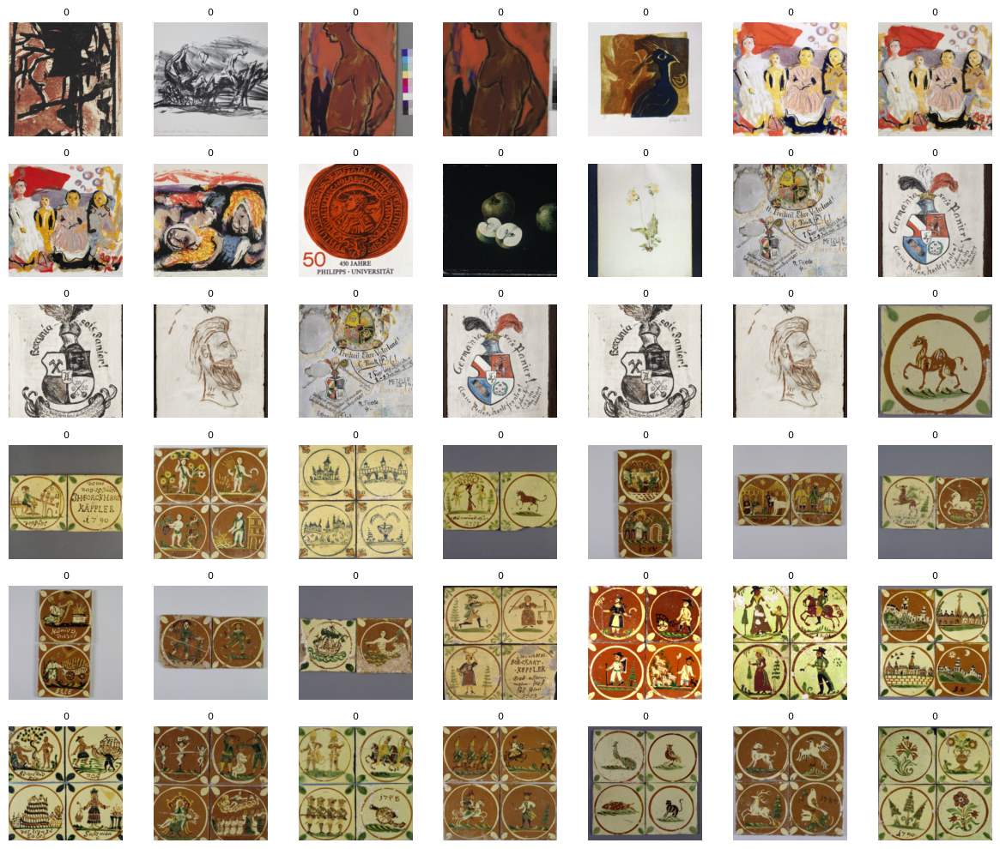

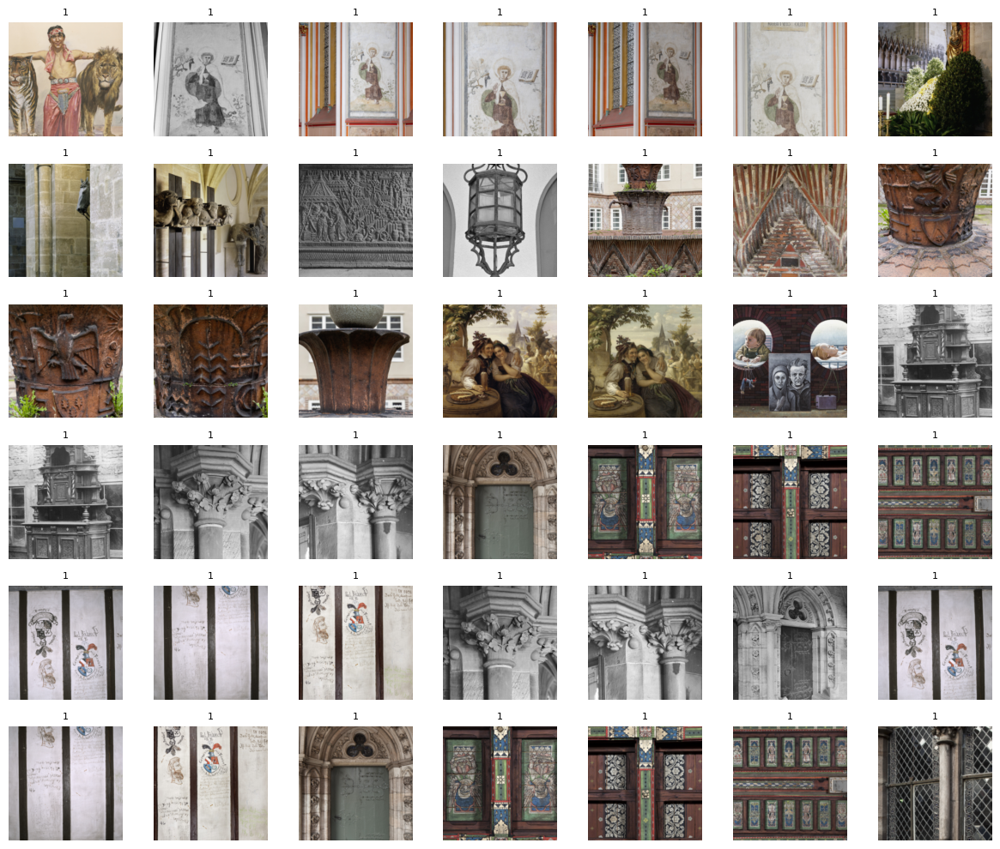

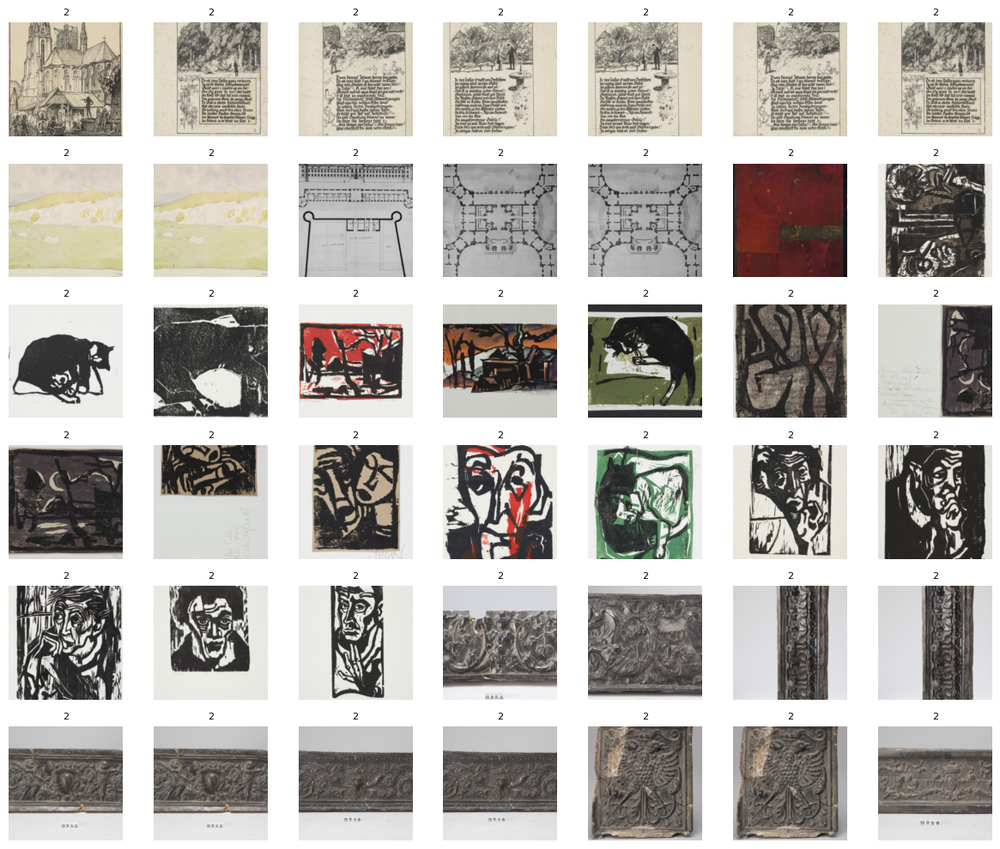

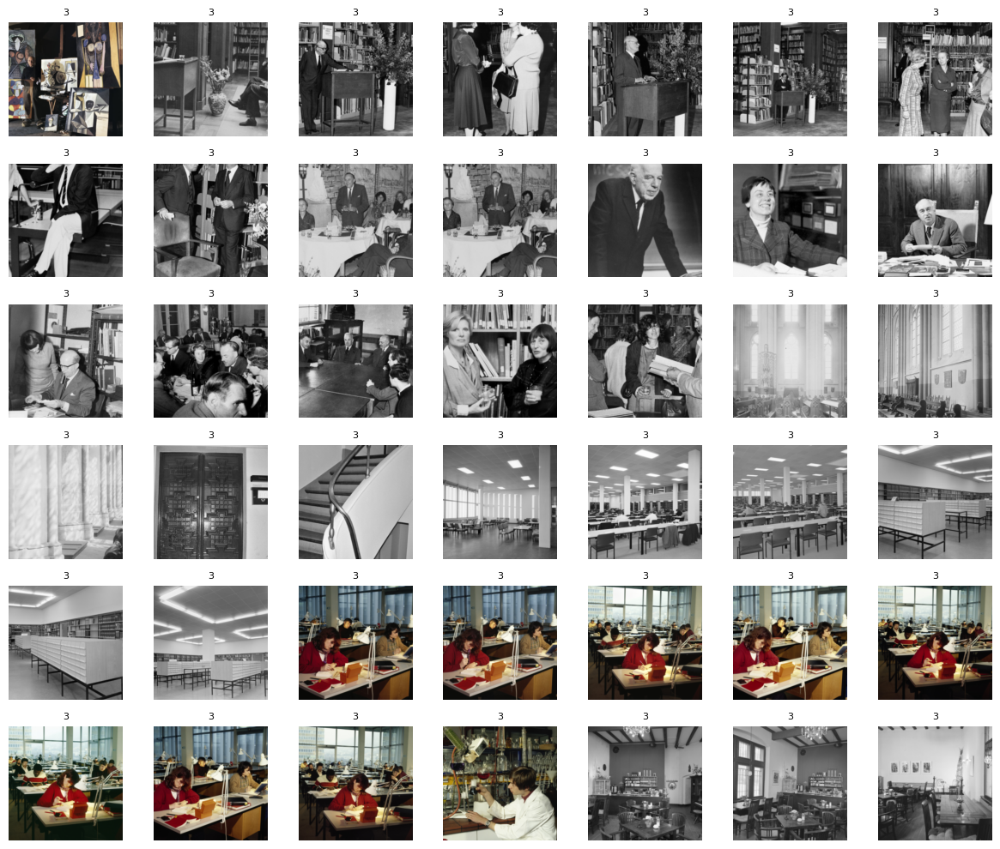

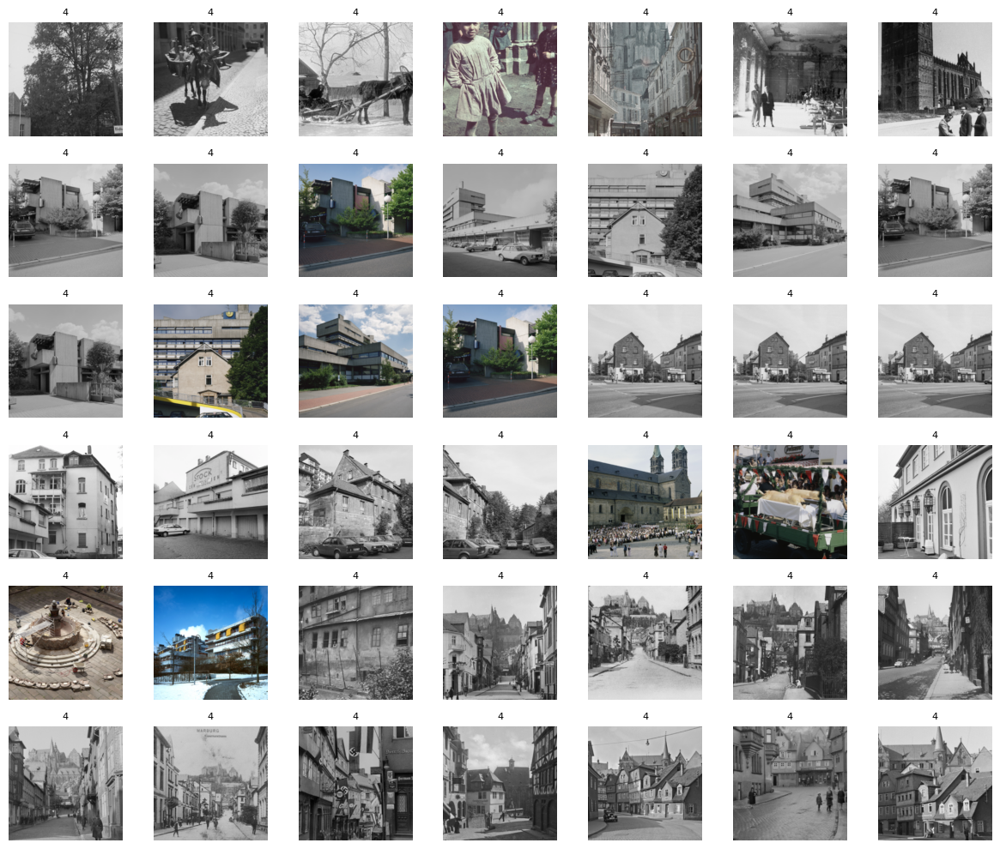

...

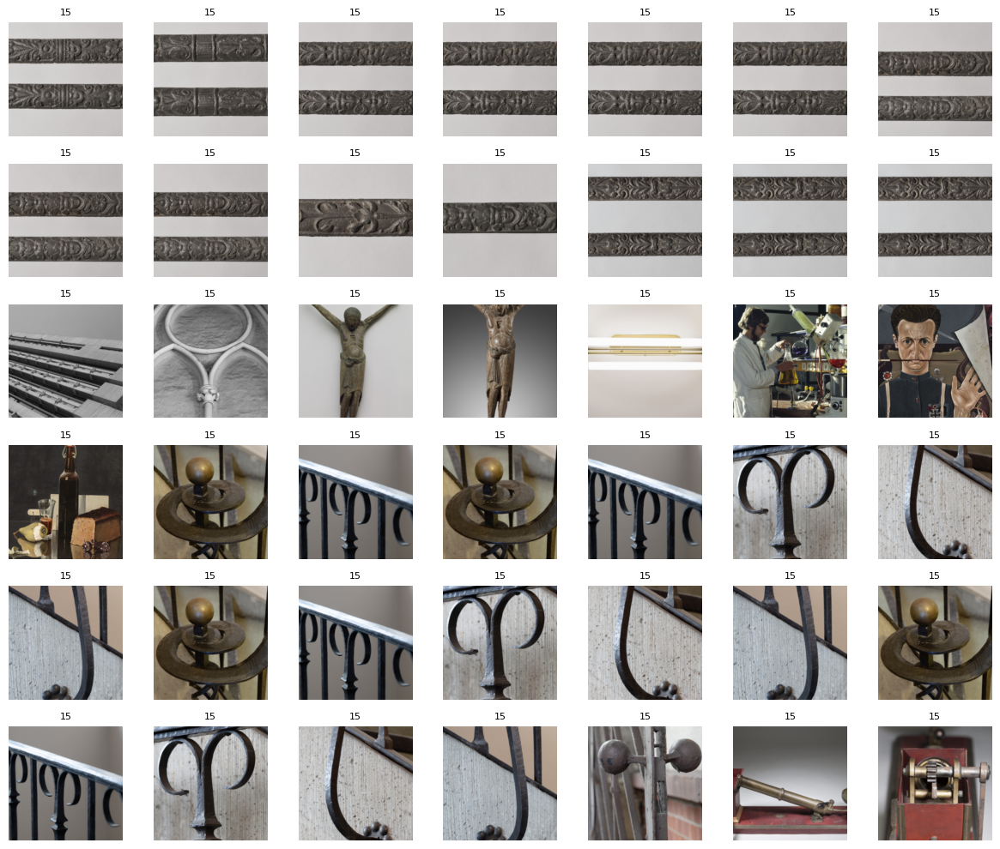

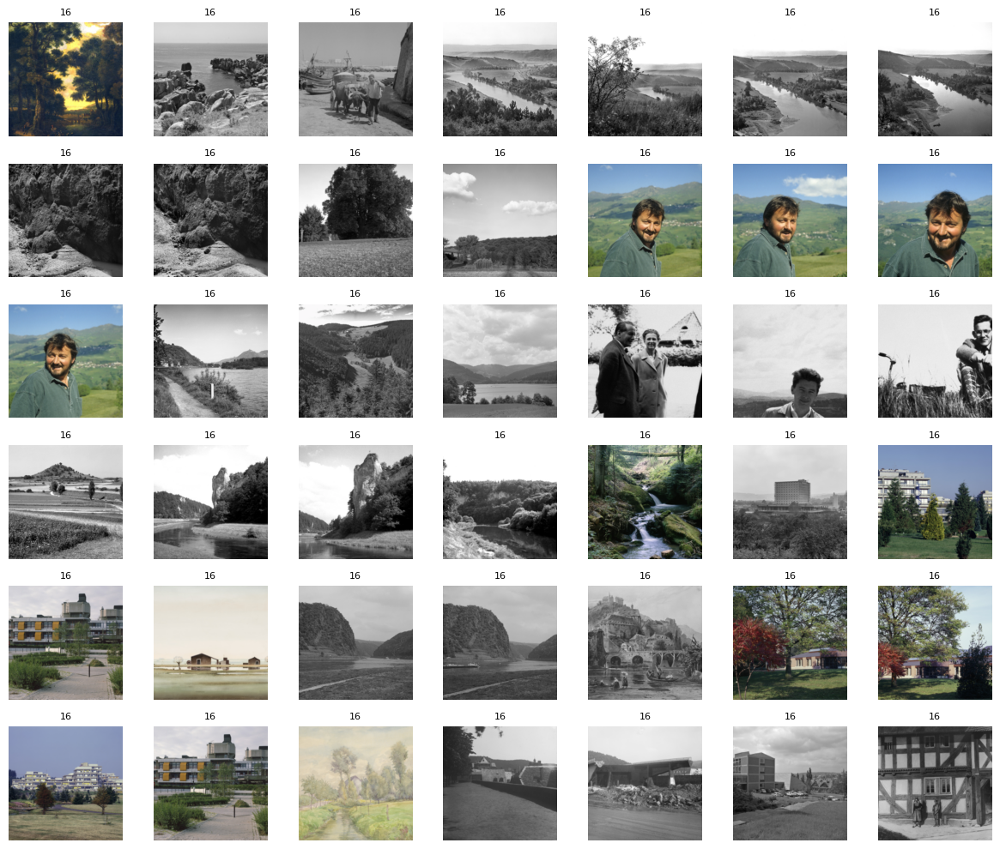

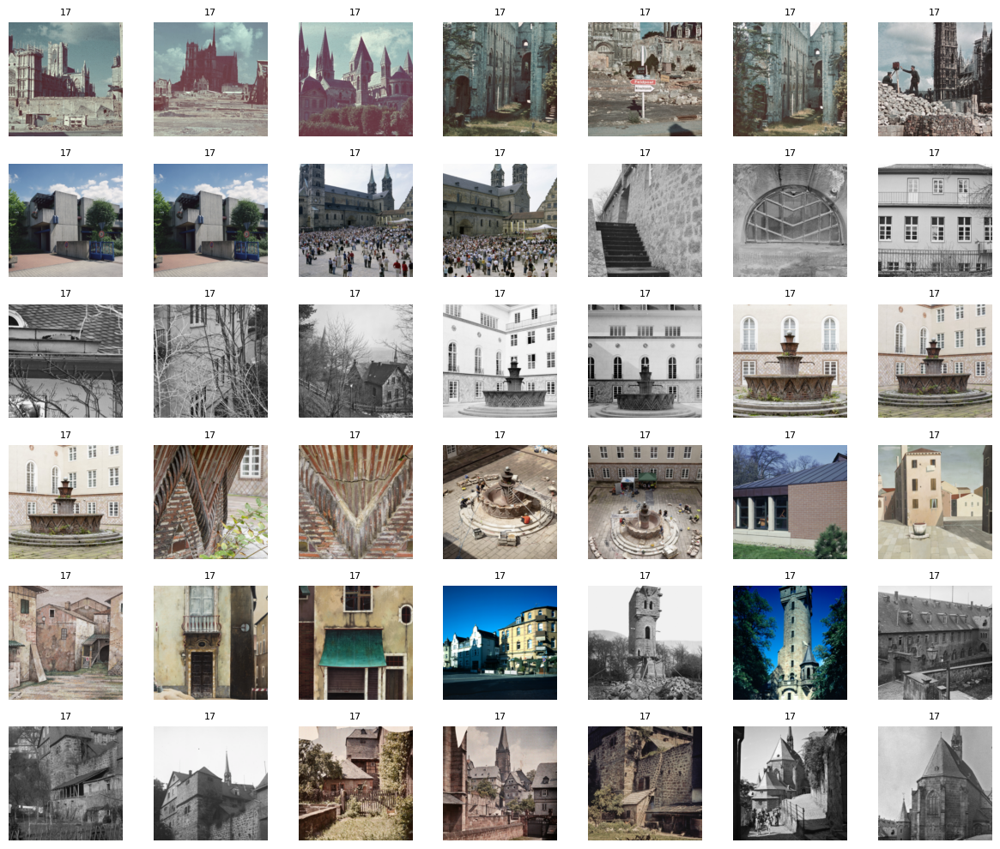

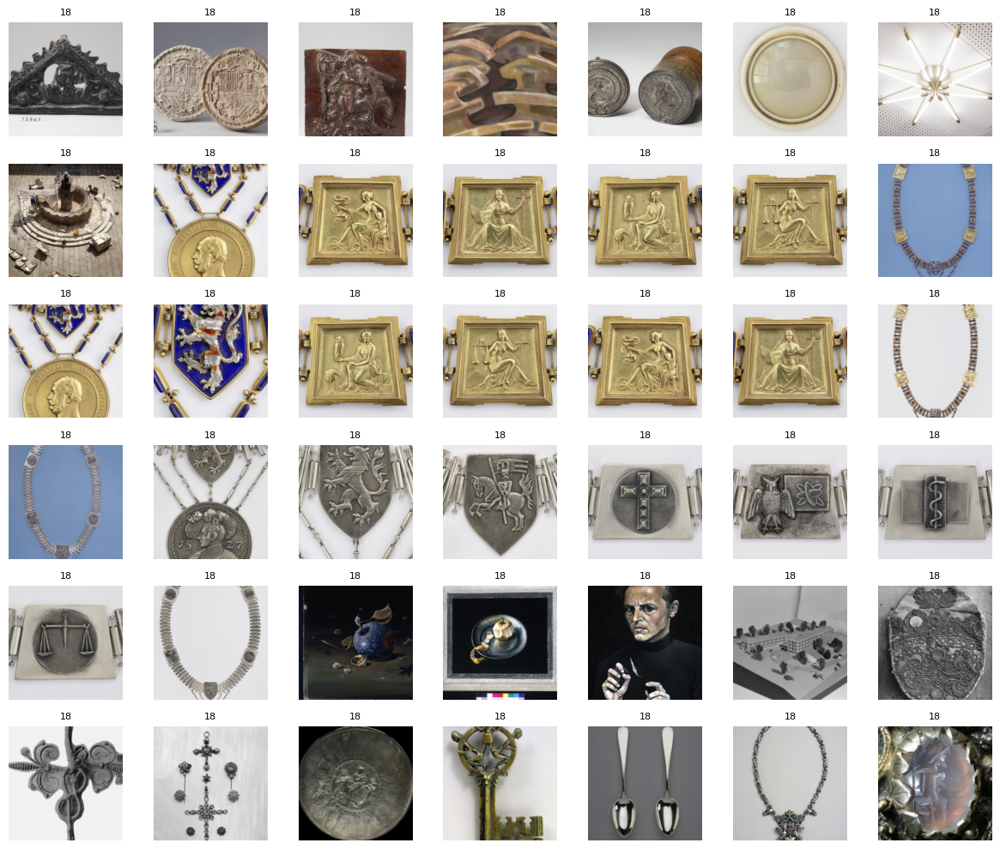

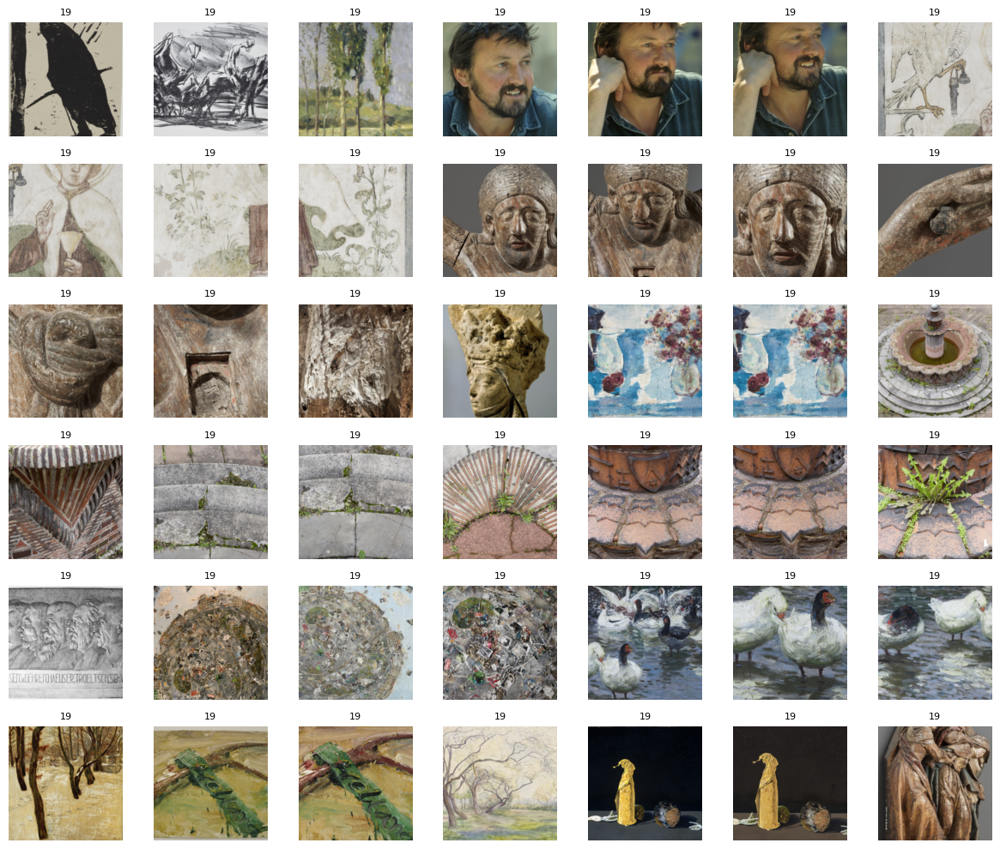

In [19]:
for k in range(20):
    m, n = 6, 7
    N = m*n
    fig, axes = plt.subplots(m, n, figsize=(m*2, 10))
    axes = axes.flatten()

    idx = -1
    # for idx, image_name in enumerate([file_names[i] for i in random_indexes]):
    for image_name, label in zip(file_names[:AMOUNT_OF_IMAGES], clusters):
        
        if label != k:
            continue
        
        if idx == N-1:
            break
        else:
            idx += 1
        
        # Load the image
        image_path = f'{folder_path}/{image_name}'
        try:
            image = Image.open(image_path)
        
            # Preprocess the image (handle grayscale to RGB conversion)
            image_tensor = preprocess_image(image)

            # Plot the image in the corresponding subplot
            img_tensor = image_tensor.squeeze(0).permute(1, 2, 0)  # Remove batch dimension and rearrange to (H, W, C)
            img_tensor = img_tensor * torch.tensor([0.229, 0.224, 0.225]) + torch.tensor([0.485, 0.456, 0.406])  # Un-normalize
            img_tensor = torch.clamp(img_tensor, 0, 1)  # Clamp to [0,1]

            # Convert to numpy array for plottAing
            img_np = img_tensor.numpy()
            
            axes[idx].imshow(img_np)
            axes[idx].axis('off')  # Hide axis
            axes[idx].set_title(label, fontsize=8)  # Set the title as the predicted label
        except Exception as e:  
            print(f'Error processing {image_name}: {e}')

    # Hide any remaining subplots if we have fewer images than subplots
    for ax in axes[len(file_names[:N]):]:
        ax.axis('off')

    plt.tight_layout()
    plt.show()


In [20]:
# pca = PCA(n_components=2)
# reduced_features = pca.fit_transform(features_array)
tsne = TSNE(n_components=2)
reduced_features = tsne.fit_transform(features_array)

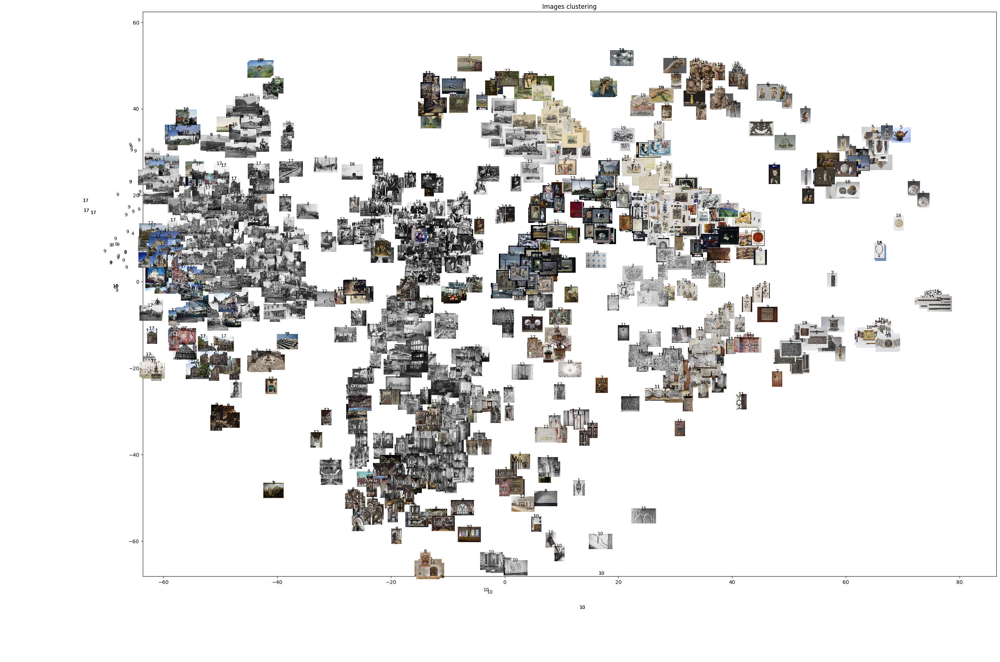

In [31]:
def imscatter(x, y, image_paths, ax=None, zoom=0.1):
    if ax is None:
        ax = plt.gca()
    pictures = []
    for i, image_path in enumerate(image_paths):
        try:
            img = plt.imread(folder_path+'/'+image_path)
            if len(img.shape) == 2:  # grayscale
                im = OffsetImage(img, zoom=zoom, cmap='gray')
            else:  # color
                im = OffsetImage(img, zoom=zoom)
            ab = AnnotationBbox(im, (x[i], y[i]), xycoords='data', frameon=False)
            pictures.append(ax.add_artist(ab))
            ax.text(x[i], y[i] + 1.5, clusters[i], color='black', fontsize=9, ha='center')
        except Exception as e:
            print(f"Error loading image {folder_path+'/'+image_path}: {e}")
    return pictures



fig, ax = plt.subplots(figsize=(30, 20))
x_vals = reduced_features[:, 0]
y_vals = reduced_features[:, 1]

IMAGES_TO_PLOT=1500
imscatter(x_vals[:IMAGES_TO_PLOT], y_vals[:IMAGES_TO_PLOT], file_names[:IMAGES_TO_PLOT], ax=ax, zoom=0.025)
# imscatter(x_vals, y_vals, file_names[:AMOUNT_OF_IMAGES], ax=ax, zoom=0.025)

ax.set_title('Images clustering')
plt.xlim(min(x_vals)+10, max(x_vals)+10)
plt.ylim(min(y_vals)+10, max(y_vals)+10)
plt.show()

# TURTLE clusterisation
The code is built with the following libraries

PyTorch - 2.2.1  
torchvision - 0.17.1  
numpy  
scipy  
scikit-learn  
clip  
tqdm  
cuml - 24.02


In [9]:
wget https://brbiclab.epfl.ch/wp-content/uploads/2024/06/turtle_tasks.zip


"wget" ­Ґ пў«пҐвбп ў­гваҐ­­Ґ© Ё«Ё ў­Ґи­Ґ©
Є®¬ ­¤®©, ЁбЇ®«­пҐ¬®© Їа®Ја ¬¬®© Ё«Ё Ї ЄҐв­л¬ д ©«®¬.


In [127]:
# pip create -n rapids-24.08 -c rapidsai -c conda-forge -c nvidia rapids=24.08 python=3.11 'cuda-version>=12.0,<=12.5'

Note: you may need to restart the kernel to use updated packages.


ЌҐ г¤ Ґвбп ­ ©вЁ гЄ § ­­л© д ©«.


# Transfer learning
https://machinelearningmastery.com/how-to-use-transfer-learning-when-developing-convolutional-neural-network-models/